# Базовый курс по методам анализа данных и машинного обучения

## Практическое занятие 4. Оптимизация. Параметрическая идентификация.

<br><br><br><br>
__Аксентьев Артем (akseart@ya.ru)__

__Ксемидов Борис (nstalker.anonim@yandex.ru)__
<br>

### Градиентный спуск

Рассмотрим функцию:

$f(x) = x^2$

In [1]:
import numpy as np

def func(x):
    return np.square(x)

In [2]:
import plotly.express as px
import plotly.io as pio

pio.renderers.default = 'plotly_mimetype+notebook'

x = np.linspace(-5, 5, 300)
y = func(x)
fig = px.line(x=x, y=y, width=600, height=600)
fig.show()


Производная $f(x) = x^2$:

$f'(x) = 2x$

In [4]:
def deriv(x):
    return 2 * x

In [5]:
x = np.linspace(-5, 5, 300)
y = func(x)
fig = px.line(x=x, y=y, width=600, height=600)

sc_x = 2
color = "purple"
antigradient_point = sc_x - 0.25 * deriv(sc_x)
gradient_point = sc_x + 0.25 * deriv(sc_x)

fig.add_scatter(
    x=[sc_x, antigradient_point],
    y=[func(sc_x), func(antigradient_point)],
    showlegend=False,
    line=dict(color=color))


fig.add_scatter(
    x=[sc_x, gradient_point],
    y=[func(sc_x), func(gradient_point)],
    showlegend=False,
    line=dict(color=color))

fig.add_annotation(
    ax=sc_x,  # arrows' head
    ay=func(sc_x),  # arrows' head
    x=antigradient_point,  # arrows' tail
    y=func(antigradient_point),  # arrows' tail
    xref='x',
    yref='y',
    axref='x',
    ayref='y',
    text='',  # if you want only the arrow
    showarrow=True,
    arrowhead=3,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor=color
)


fig.add_annotation(
    ax=sc_x,  # arrows' head
    ay=func(sc_x),  # arrows' head
    x=gradient_point,  # arrows' tail
    y=func(gradient_point),  # arrows' tail
    xref='x',
    yref='y',
    axref='x',
    ayref='y',
    text='',  # if you want only the arrow
    showarrow=True,
    arrowhead=3,
    arrowsize=1,
    arrowwidth=2,
    arrowcolor=color
)

mid_gradient = sc_x + (gradient_point - sc_x) / 2
mid_antigradient = sc_x - (sc_x - antigradient_point) / 2

fig.add_annotation(x=mid_gradient, y=func(mid_gradient),
                   text="Градиент",
                   showarrow=True,
                   ax=50,
                   ay=20,
                   arrowhead=1, arrowwidth=1.5)

fig.add_annotation(x=mid_antigradient, y=func(mid_antigradient),
                   text="Антиградиент",
                   showarrow=True,
                   ax=50,
                   ay=20,
                   arrowhead=1, arrowwidth=1.5)
fig.show()


Градиент для функции одной переменной:

$\nabla f(x) = (\frac{\partial f}{\partial x})$, где
- $\nabla$ - оператор набла;
- $\frac{\partial f}{\partial x}$ - частная производная функции $f(x)$ по переменной x.

Антиградиент будет равен $(- \nabla f(x))$.

Градиент для функции многих переменных:

$\nabla f(x, y, z) = (\frac{\partial f(x, y, z)}{\partial x}, \frac{\partial f(x, y, z)}{\partial y}, \frac{\partial f(x, y, z)}{\partial z})$

Общая формула градиентного шага:

$x^{(k+1)} = x^{(k)} - \alpha^{(k)} \nabla f(x^{(k)})$, где
- $\alpha$ - скорость оптимизации или скорость градиентного спуска;
- $\nabla$ - оператор набла, а $\nabla f(x)$ - вектор значений частных производных функции $f(x)$ по всем переменным в точке x;
- k - номер шага;
- $x^{(k)}$ - вектор переменных функции на k-м шаге, например, для функции $f(x_1, x_2)$ будет $x = (x_1, x_2)$.


Алгоритм:
1. Задаем начальное приближение ($x = x_0$).
2. Задаем максимальное число итераций.
3. Задаем скорость оптимизации ($\alpha$).
4. Задаем точность расчёта $\epsilon$.
5. Пока не достигнем максимального числа итераций:
    - считаем градиент: $g = \nabla f(x^{(k)})$;
    - считаем новую оптимальную точку в направлении антиградиента: $x^{(k+1)} = x^{(k)} - \alpha g$;
    - если модуль разницы в значении функции предыдущей точки и новой меньше или равно $\epsilon$, то есть $|f(x^{(k)}) - f(x^{(k+1)})| \leq \epsilon$ и $|x^{k} - x^{k-1}| \leq \epsilon$, то выходим.
6. Возвращаем последнюю найденную оптимальную точку.

In [6]:
def optimize(x0, func, deriv, lr=1e-2, eps=1e-5, max_iter=100):
    traces = []
    x_curr = x0

    for _ in range(max_iter):
        f_curr = func(x_curr)
        traces.append((x_curr, f_curr))

        x_next = x_curr - lr * deriv(x_curr)
        f_next = func(x_next)
        
        if np.abs(f_next - f_curr) <= eps and np.linalg.norm(x_next - x_curr) <= eps:
            break

        x_curr = x_next
    else:
        print("Max iter")

    return x_next, np.array(traces)
        

In [7]:
min_x, traces = optimize(2, func, deriv, lr=0.3)
min_x


5.368709120000004e-06

In [8]:
import plotly.graph_objects as go

# https://plotly.com/python/animations/
fig = go.Figure(
    data=[
        go.Scatter(
            x=[traces[0, 0]], y=[traces[0, 1]],
            name="Оптимизация",
            mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red")),
        go.Scatter(
            x=x, y=y,
            name="Функция",
            mode="lines",
            line=dict(width=2, color="blue"))
    ],
    layout=go.Layout(
        title="Градиентный спуск",
        width=700,
        height=700,
        xaxis=dict(range=[-3, 3], autorange=False, zeroline=False),
        yaxis=dict(range=[-1, 5], autorange=False, zeroline=False),
        # hovermode="closest",
        updatemenus=[dict(
            type="buttons",
            buttons=[dict(label="Play",
                          method="animate",
                          args=[None])])]
    ),
    frames=[
        go.Frame(data=[
            go.Scatter(
                x=traces[:i, 0], y=traces[:i, 1],
                mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red"))])
        for i in range(1, len(traces))]
)
fig.show()


In [10]:
min_x, traces = optimize(2, func, deriv, lr=1, max_iter=4)
min_x


Max iter


2

In [11]:
import plotly.graph_objects as go


def interpolate_traces(traces, func):
    interpolated_traces = []

    for i in range(len(traces) - 1):
        x_range = np.linspace(traces[i][0], traces[i + 1][0], 100)
        for point in x_range:
            interpolated_traces.append((point, func(point), i))

    return np.array(interpolated_traces)


interpolated_traces = interpolate_traces(traces, func)

# https://plotly.com/python/animations/
fig = go.Figure(
    data=[
        go.Scatter(
            x=[traces[0, 0]], y=[traces[0, 1]],
            name="Оптимизация",
            mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red")),
        go.Scatter(
            x=x, y=y,
            name="Функция",
            mode="lines",
            line=dict(width=2, color="blue"))
    ],
    layout=go.Layout(
        title="Градиентный спуск",
        width=700,
        height=700,
        xaxis=dict(range=[-3, 3], autorange=False, zeroline=False),
        yaxis=dict(range=[-1, 5], autorange=False, zeroline=False),
        # hovermode="closest",
        updatemenus=[dict(
            type="buttons",
            buttons=[
                dict(label="Play",
                     method="animate",
                     args=[None, {"frame": {"duration": 0.0000001, "redraw": True}, }]),
                {"args": [[None], {"frame": {"duration": 0, "redraw": False},
                                   "mode": "immediate",
                                   "transition": {"duration": 0}}],
                 "label": "Pause",
                 "method": "animate"
                 }

            ])]
    ),
    frames=[
        go.Frame(data=[
            go.Scatter(
                x=[interpolated_traces[i, 0]], y=[interpolated_traces[i, 1]],
                mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red"))],
            layout=go.Layout(title_text=f"Градиентный спуск (шаг {int(interpolated_traces[i, 2]) + 1})"))
        for i in range(1, len(interpolated_traces))]
)

fig.show()


In [12]:
min_x, traces = optimize(2, func, deriv, lr=0.75, max_iter=10)
min_x


Max iter


0.001953125

In [13]:
interpolated_traces = interpolate_traces(traces, func)

# https://plotly.com/python/animations/
fig = go.Figure(
    data=[
        go.Scatter(
            x=[traces[0, 0]], y=[traces[0, 1]],
            name="Оптимизация",
            mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red")),
        go.Scatter(
            x=x, y=y,
            name="Функция",
            mode="lines",
            line=dict(width=2, color="blue"))
    ],
    layout=go.Layout(
        title="Градиентный спуск",
        width=700,
        height=700,
        xaxis=dict(range=[-3, 3], autorange=False, zeroline=False),
        yaxis=dict(range=[-1, 5], autorange=False, zeroline=False),
        # hovermode="closest",
        updatemenus=[dict(
            type="buttons",
            buttons=[
                dict(label="Play",
                     method="animate",
                     args=[None, {"frame": {"duration": 0.0000001, "redraw": True}, }]),
                {"args": [[None], {"frame": {"duration": 0, "redraw": False},
                                   "mode": "immediate",
                                   "transition": {"duration": 0}}],
                 "label": "Pause",
                 "method": "animate"
                 }

            ])]
    ),
    frames=[
        go.Frame(data=[
            go.Scatter(
                x=[interpolated_traces[i, 0]], y=[interpolated_traces[i, 1]],
                mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red"))],
            layout=go.Layout(title_text=f"Градиентный спуск (шаг {int(interpolated_traces[i, 2]) + 1})"))
        for i in range(1, len(interpolated_traces))]
)

fig.show()


In [14]:
def func_2(x):
    return x * np.sin(x)

def deriv_2(x):
    return np.sin(x) + x * np.cos(x)


x = np.linspace(-2, 7, 300)
y = func_2(x)
fig = px.line(x=x, y=y, width=600, height=600)
fig.show()


In [15]:
min_x, traces = optimize(6, func_2, deriv_2, lr=0.75, max_iter=10)
min_x

Max iter


-0.0013728832266163334

In [16]:
interpolated_traces = interpolate_traces(traces, func_2)

# https://plotly.com/python/animations/
fig = go.Figure(
    data=[
        go.Scatter(
            x=[traces[0, 0]], y=[traces[0, 1]],
            name="Оптимизация",
            mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red")),
        go.Scatter(
            x=x, y=y,
            name="Функция",
            mode="lines",
            line=dict(width=2, color="blue"))
    ],
    layout=go.Layout(
        title="Градиентный спуск",
        width=700,
        height=700,
        xaxis=dict(range=[-2, 7], autorange=False, zeroline=False),
        yaxis=dict(range=[-5, 5], autorange=False, zeroline=False),
        # hovermode="closest",
        updatemenus=[dict(
            type="buttons",
            buttons=[
                dict(label="Play",
                     method="animate",
                     args=[None, {"frame": {"duration": 0.0000001, "redraw": True}, }]),
                {"args": [[None], {"frame": {"duration": 0, "redraw": False},
                                   "mode": "immediate",
                                   "transition": {"duration": 0}}],
                 "label": "Pause",
                 "method": "animate"
                 }

            ])]
    ),
    frames=[
        go.Frame(data=[
            go.Scatter(
                x=[interpolated_traces[i, 0]], y=[interpolated_traces[i, 1]],
                mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red"))],
            layout=go.Layout(title_text=f"Градиентный спуск (шаг {int(interpolated_traces[i, 2]) + 1})"))
        for i in range(1, len(interpolated_traces))]
)

fig.show()

Геометрический смысл производной: 

$f'(x) = k$ 
<!-- = \tg \alpha -->

<!-- $\tg \alpha = \frac{BC}{AC} = \frac{dy}{dx}$

$dy = \tg \alpha\ dx = f'(x)\ dx$ -->

Уравнение прямой:

$f(x) = k x + b$

In [17]:
x = np.linspace(-2, 7, 300)
y = func_2(x)
fig = px.line(x=x, y=y, width=600, height=600)

def tangent(x, a, b):
    x_line = np.linspace(a, b, 30)
    b_line = func_2(x) - deriv_2(x) * x
    y_line = deriv_2(x) * x_line + b_line
    return x_line, y_line


x_line, y_line = tangent(6, 5, 7)
fig.add_trace(go.Line(
    x=x_line, y=y_line,
    name=f"Касательная x = 6"
))

x_line, y_line = tangent(1, 0, 2)
fig.add_trace(go.Line(
    x=x_line, y=y_line,
    name=f"Касательная x = 1"
))

fig.show()

/opt/homebrew/Caskroom/miniconda/base/lib/python3.8/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.




Геометрический смысл производной: 

$f'(x) = \tg \alpha $ 

$\tg \alpha = \frac{BC}{AC} = \frac{dy}{dx}$


In [18]:
x = np.linspace(-5, 5, 300)
y = func(x)
fig = px.line(x=x, y=y, width=600, height=600)

sc_x = 2
fig.add_scatter(
    x=[sc_x, sc_x+1, sc_x+1, sc_x],
    y=[func(sc_x), func(sc_x+1), func(sc_x), func(sc_x)],
    name="Производная")

fig.add_annotation(x=sc_x+1, y=(func(sc_x+1) + func(sc_x)) // 2,
            text="dy",
            showarrow=True,
            ax=15,
            arrowhead=1)

fig.add_annotation(x=sc_x + 0.5, y=func(sc_x),
            text="dx",
            showarrow=True,
            ay=20,
            arrowhead=1)

fig.add_annotation(x=sc_x, y=func(sc_x),
            text="A",
            showarrow=True,
            ay=-25,
            ax=-10,
            arrowhead=1)

fig.add_annotation(x=sc_x+1, y=func(sc_x+1),
            text="B",
            showarrow=True,
            ay=-25,
            ax=-10,
            arrowhead=1)


fig.add_annotation(x=sc_x+1, y=func(sc_x),
            text="C",
            showarrow=True,
            ax=20,
            ay=20,
            arrowhead=1)


fig.show()


In [19]:
import plotly.io as pio
import plotly.graph_objects as go


def func_3(x):
    sum1 = 0
    sum2 = 0
    for i in range(1, 4):
        sum1 = sum1 + (i * np.cos(((i+1)*x[0]) + i))
        sum2 = sum2 + (i * np.cos(((i+1)*x[1]) + i))
    return sum1 * sum2

from sympy import *

sym_x, sym_y = symbols('x y')

sum1 = 0
sum2 = 0

for i in range(1, 4):
    sum1 = sum1 + (i * cos(((i+1)*sym_x) + i))
    sum2 = sum2 + (i * cos(((i+1)*sym_y) + i))

f_3_dx, f_3_dy = diff(sum1 * sum2, sym_x), diff(sum1 * sum2, sym_y)

def deriv_3(x):
    return np.array([f_3_dx.subs([(sym_x, x[0]), (sym_y, x[1])]).evalf(), f_3_dy.subs([(sym_x, x[0]), (sym_y, x[1])]).evalf()], dtype=np.float32)


pio.renderers.default = 'plotly_mimetype+notebook'

points_x_1, points_x_2 = np.linspace(-1, 2, 300), np.linspace(-1, 2, 300)
x_grid_1, x_grid_2 = np.meshgrid(points_x_1, points_x_2)
z_grid = func_3((x_grid_1, x_grid_2))

fig = go.Figure(data=[go.Surface(x=x_grid_1, y=x_grid_2, z=z_grid)],)

fig.update_layout(autosize=False,
                  width=700, height=700)

fig.show()


In [20]:

min_x, traces = optimize(np.array([0.25, 0.5]), func_3, deriv_3, lr=0.005, max_iter=5)
min_x


Max iter


/var/folders/lm/0j0v2m453ks57mmwdnjfvz700000gn/T/ipykernel_62282/236261775.py:19: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



array([0.16969232, 0.93793982])

In [21]:
import plotly.graph_objects as go
import plotly.io as pio

pio.renderers.default = 'plotly_mimetype+notebook'

points_x_1, points_x_2 = np.linspace(-1, 2, 300), np.linspace(-1, 2, 300)
x_grid_1, x_grid_2 = np.meshgrid(points_x_1, points_x_2)
z_grid = func_3((x_grid_1, x_grid_2))


fig = go.Figure(
    data=[
        go.Scatter3d(x=[traces[0][0][0]], y=[traces[0][0][1]], z=[
                     traces[0][1]], marker={"color": "red"}),
        go.Surface(x=x_grid_1, y=x_grid_2, z=z_grid)
    ],
    layout=go.Layout(
        title="Градиентный спуск",
        width=700,
        height=700,
        xaxis=dict(range=[-1, 2], autorange=False, zeroline=False),
        yaxis=dict(range=[-1, 2], autorange=False, zeroline=False),
        # hovermode="closest",
        updatemenus=[dict(
            type="buttons",
            buttons=[
                dict(label="Play",
                     method="animate",
                     args=[None, {"frame": {"duration": 0.0000001, "redraw": True}, }]),
                {"args": [[None], {"frame": {"duration": 0, "redraw": False},
                                   "mode": "immediate",
                                   "transition": {"duration": 0}}],
                 "label": "Pause",
                 "method": "animate"
                 }

            ])]
    ),
    frames=[
        go.Frame(data=[
            go.Scatter3d(
                x=np.array(traces[:i, 0].tolist())[:, 0], y=np.array(
                    traces[:i, 0].tolist())[:, 1], z=traces[:i, 1],
                mode="markers+lines", line=dict(color="red"), marker=dict(size=10, color="red"))])
        for i in range(1, len(traces))]
)

fig.show()


### Параметрическая идентификация

Модель хищник-жертва:

\begin{cases}
U' = -a * U + \gamma_U * U * V\\
V' = -\gamma_V * U * V + b * V - c * V * V
\end{cases}

Обозначения:
- U - хищник;
- V - жертва.

In [19]:
from ipywidgets import interactive
import numpy as np
from scipy.integrate import odeint
from matplotlib import pyplot as plt

In [20]:
# Размеры графиков
FIG_SIZE = (20, 10)

# Шаг по времени
STEP_T = 0.01

In [21]:
from scipy.fftpack import fft, ifft


def model(u_0, v_0, t_max, a, b, c, gamma_U, gamma_V):
    def compute(begin, t, a, b, c, gamma_U, gamma_V):
        U, V = begin
        return -a * U + gamma_U * U * V, -gamma_V * U * V + b * V - c * V * V

    t = np.arange(0.0, t_max, STEP_T)
    # n = int(t_max // STEP_T)
    args = a, b, c, gamma_U, gamma_V
    values = odeint(compute, (u_0, v_0), t, args=args)

    _, axes = plt.subplots(1, 2, figsize=FIG_SIZE)

    axes[0].plot(t, values[:, 0])
    axes[0].plot(t, values[:, 1])
    axes[1].plot(values[:, 0], values[:, 1])

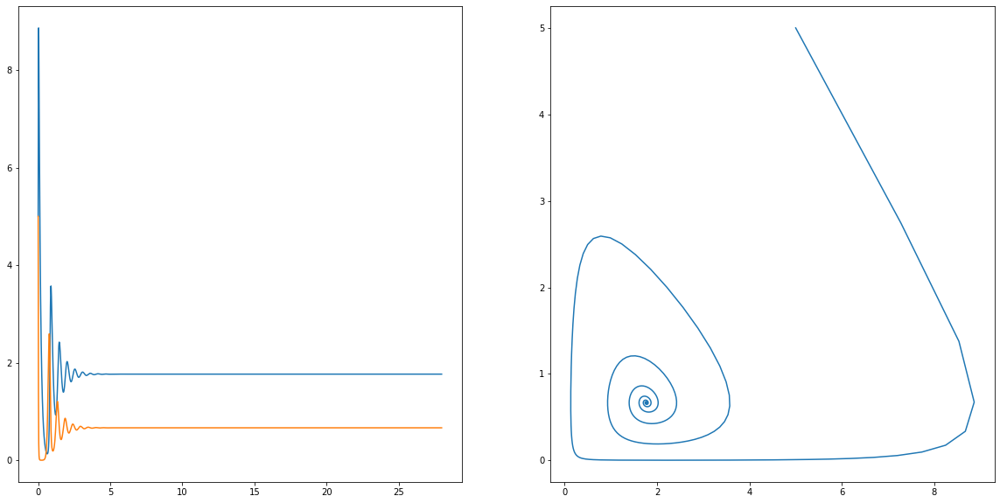

In [22]:
model(5, 5, 28, 8, 21, 5, 12, 10)

$$
\begin{cases}
U' = 1 + a * V * W\\
V' = U - V\\
W' = 1 - U * V\\
\end{cases}
$$

In [23]:
def model(u_0, v_0, w_0, t_max, a, plot=True):
    def compute(begin, t, a):
        U, V, W = begin
        return 1 + a * V * W, U - V, 1 - U * V

    t = np.arange(0.0, t_max, STEP_T)
    # n = int(t_max // STEP_T)
    args = (a, )
    values = odeint(compute, (u_0, v_0, w_0), t, args=args)

    if plot:
        _, axes = plt.subplots(1, 1, figsize=FIG_SIZE)

        axes.plot(t, values[:, 0])
        axes.plot(t, values[:, 1])
        axes.plot(t, values[:, 2])
        axes.legend(['U', 'V', 'W'])
    return values

array([[ 5.        ,  5.        ,  5.        ],
       [ 5.22952932,  5.00115293,  4.754196  ],
       [ 5.44783453,  5.00452269,  4.49707169],
       ...,
       [ 0.85445496,  0.95655385, -1.1781401 ],
       [ 0.85432564,  0.95553728, -1.17630843],
       [ 0.85422283,  0.95452968, -1.17446701]])

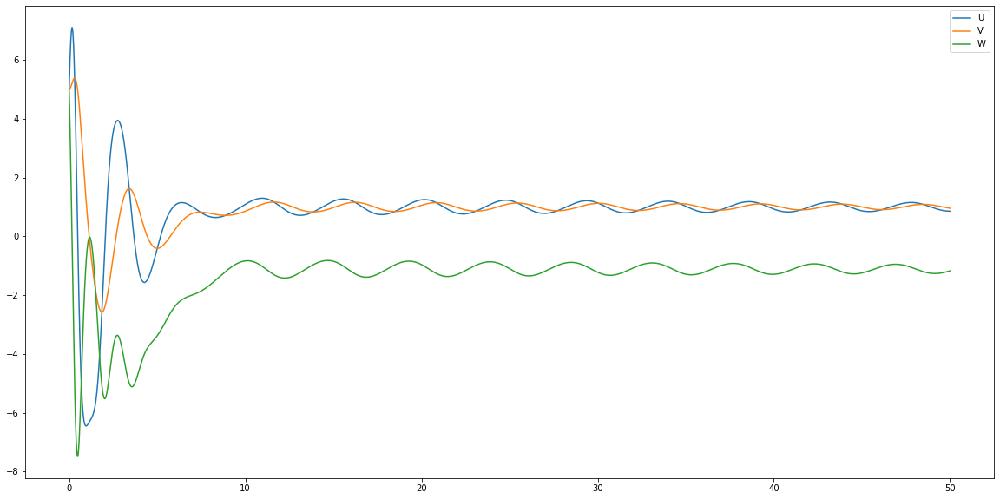

In [24]:
model(5, 5, 5, 50, 0.9)

In [25]:
def compute_diff_system(begin, t, a):
    U, V, W = begin
    return 1 + a * V * W, U - V, 1 - U * V

In [26]:
def animal_model(a, u_0=5, v_0=5, w_0=5, t_max=10):
    t = np.arange(0.0, t_max, 0.02)

    args = (a, )
    res = odeint(
        compute_diff_system, [u_0, v_0, w_0], t, args=args)
    
    return res[:, 0]

In [27]:
corrects = animal_model(1)

$$
MSE = \frac{1}{n} \sum\limits_n (y - \hat{y})^ 2
$$

In [28]:
corrects

array([ 5.        ,  5.49530491,  5.93842809,  6.32516843,  6.65134871,
        6.91289511,  7.10594766,  7.22699831,  7.27305149,  7.24179931,
        7.1318027 ,  6.94266689,  6.67519848,  6.33153086,  5.91520488,
        5.43119344,  4.88586165,  4.2868587 ,  3.64294226,  2.96374221,
        2.25947549,  1.54062854,  0.81762654,  0.10050976, -0.60136346,
       -1.27957052, -1.92682258, -2.53709947, -3.10571943, -3.62934637,
       -4.10594169, -4.5346703 , -4.91577224, -5.2504118 , -5.54051496,
       -5.78860535, -5.99764639, -6.17089564, -6.31177548, -6.42376212,
       -6.5102937 , -6.5746971 , -6.6201321 , -6.64955105, -6.66567192,
       -6.67096256, -6.66763405, -6.6576411 , -6.64268774, -6.62423686,
       -6.60352228, -6.58156228, -6.55917393, -6.53698749, -6.51546047,
       -6.4948911 , -6.47543103, -6.45709711, -6.4397823 , -6.42326575,
       -6.40722217, -6.39123055, -6.37478245, -6.35729001, -6.33809381,
       -6.31647083, -6.29164267, -6.26278416, -6.2290325 , -6.18

In [29]:
def loss(correct, predict):
    if not isinstance(correct, np.ndarray):
        correct = np.array(correct)
    if not isinstance(predict, np.ndarray):
        predict = np.array(predict)
    return np.sum(np.square(correct - predict))

In [30]:
def loss_model_a(a, expected):
    preds = []
    corrects = []
    for correct_a in expected:
        predict = animal_model(a)
        preds.append(predict)
        corrects.append(correct_a)

    return loss(preds, corrects) / len(expected)

In [31]:
from scipy.optimize import minimize

a0 = 1.5
args = (corrects, )
res = minimize(loss_model_a, a0, method='nelder-mead',
               options={'xatol': 1e-4, 'disp': True}, args=args)

Optimization terminated successfully.
         Current function value: 0.000004
         Iterations: 15
         Function evaluations: 30


In [32]:
res.x

array([0.99997559])